<a href="https://colab.research.google.com/github/choiminji-020102/Image-processing_Deep-learning/blob/main/13_DCGAN_tutorial.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# DCGAN 튜토리얼
이번 실습에서는 DCGAN이 무엇인지, 그리고 어떻게 구현하는지 알아보겠습니다.


# DCGAN이란 무엇일까요?

**DCGAN**(Deep Convolutional Generative Adversarial Network)은 lan GoodFellow의 original GAN의 구조를 발전시켜 최초로 <U>**고화질 영상을 생성시키는 네트워크**</U>입니다. 기존 GAN의 경우, MNIST와 같이 단순한 이미지는 잘 생성하지만 CIFAR-10과 같은 복잡한 영상에 대해서는 퀄리티가 좋지 못하게 생성한다는 한계가 있습니다.

- DCGAN(2016) 논문: https://arxiv.org/abs/1511.06434
- lan GoodFellow의 original GAN(2014) 논문: https://arxiv.org/abs/1406.2661


![original GAN](https://user-images.githubusercontent.com/46768752/142600465-0ecd62b0-6b4c-4cd3-8731-dc275dae6591.png)

# 논문에서 제시한 학습 디테일
**Preprocessing**:
- 이미지 픽셀값을 tanh activation 범위에 맞게 [-1,1]으로 조정합니다.
- Training시, mini-batch(128) & learning rate(0.0002) & Adam optimizer로 최적화를 진행합니다.
- 모든 weight는 정규분포 $\mu(0, 0.02)$로 초기화 합니다.

**저자 제안 - 최적의 모델을 위한 5가지 방법:**
- 모든 pooling layers는 discriminator의 strided convolutions와 [fractional strided convolution(transpose-conv)](https://deepai.org/machine-learning-glossary-and-terms/fractionally-strided-convolution)으로 대체합니다.
- Fully-connected layer와 pooling layers는 사용하지 않습니다.
- Generator와 Discriminator에서 Batchnorm이 사용됩니다.
- Generator의 마지막 레이어에서 활성함수(activation function)로 tanh를 사용하고, 나머지 레이어에서는 ReLu를 사용합니다.
- Discriminator는 모든 레이어에 LeakyReLu를 사용합니다.

## Generator
Generator는 Transposed Convolution, Batch Normalization and activation function layer로 구성됩니다.
- random noise의 크기를 100 -->  100x1x1 로 변경합니다.
- 입력 tensor를 upsampling하는 Transposed CNN layer로 전달합니다.
- Batch Normalization을 적용합니다.
- 마지막 레이어에는 Tanh, 나머지 레이어에는 ReLu activation을 적용합니다.

첫 번째 채널 크기는 1024이며, 최종 출력은 3x64x64 이미지가 됩니다.

| ![Generator architecture](https://raw.githubusercontent.com/aniketmaurya/ml-resources/master/images/dcgan-gen-arch.png) |
|:--:|
| *Generator architecture from the Paper* |


In [ ]:
# 학습을 위해 필요한 module을 import합니다.
import torch
from torch import nn
from torch.utils.data import DataLoader

from torchvision import datasets, transforms
from torchvision.utils import make_grid
from torch.optim import Adam
from torch.utils.data.sampler import SubsetRandomSampler

from tqdm.notebook import tqdm

import matplotlib.pyplot as plt

# 고정 seed를 설정하여 코드를 돌릴때 마다 동일한 환경을 유지할 수 있게 합니다.
torch.manual_seed(0)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# tensor로 구성된 이미지를 화면에 띄워주는 함수를 구성합니다.(이미지 시각화)
def show_tensor_images(image_tensor, num_images=25, size=(3, 64, 64)):
    '''
    image_tensor: 텐서로 구성된 이미지
    num_images: 이미지 개수
    size: 이미지 크기
    -> 이미지를 화면에 보여줍니다.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()

In [ ]:
class Generator(nn.Module):

    def __init__(self, in_channels=3, z_dim=100):
        super(Generator, self).__init__()

        # Generator모델 구성하기
        self.gen = nn.Sequential(
            self.create_upblock(z_dim, 1024, kernel_size=4, stride=1, padding=0),
            self.create_upblock(1024, 512, kernel_size=4, stride=2, padding=1),
            self.create_upblock(512, 256, kernel_size=4, stride=2, padding=1),
            self.create_upblock(256, 128, kernel_size=4, stride=2, padding=1),
            self.create_upblock(128, 3, kernel_size=4, stride=2, padding=1, final_layer=True),
        )

    # 제일 끝에 있는 layer만 Tanh, 나머지 layer는 ReLU 적용
    def create_upblock(self, in_channels, out_channels, kernel_size=5, stride=2, padding=1, final_layer=False):
        if final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias=False),
                nn.BatchNorm2d(out_channels),
                nn.Tanh()
            )
        return nn.Sequential(
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size, stride, padding, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(True)
        )

    def forward(self, noise):
        # noise의 shape = (batch_size, 100, 1, 1)
        return self.gen(noise)

## Discriminator
Discriminator의 아키텍쳐는 일반적인 image classification 모델과 동일합니다.<br>
여기에는 Convolution layers, Activation layer, BatchNormalization이 포함됩니다.

- DCGAN 논문에서는 커널 크기를 줄이기 위해 pooling layer 대신 conv layer의 stride를 사용합니다.
    - In the DCGAN paper, strides are used instead of pooling to reduce the size of a kernel.
    - feature-map의 크기를 키워야 하기 때문에 위와 같이 수행
- Fully Connected layer는 사용하지 않습니다.
- leak slope가 0.2인 Leaky ReLU를 사용합니다.


| ![Generator architecture](https://user-images.githubusercontent.com/46768752/142609554-01b85f33-c6c7-4675-b2db-f88c4aa8e8b4.png) |
|:--:|
| *Discriminator architecture from https://blog.naver.com/PostView.nhn?blogId=laonple&logNo=221201915691* |

In [ ]:
class Discriminator(nn.Module):

    def __init__(self, im_chan=3, hidden_dim=32):
        super(Discriminator, self).__init__()

        # Discriminator모델 구성하기
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim*2, hidden_dim * 4, stride=1),
            self.make_disc_block(hidden_dim*4, hidden_dim * 4, stride=2),
            self.make_disc_block(hidden_dim * 4, 1, final_layer=True),
        )

    # 위의 모델 아키텍쳐 사진과 같이 block 구성
    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2)
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride)
            )

    def forward(self, image):
        disc_pred = self.disc(image)  # discriminator의 판별 결과 (0:fake, 1:real)
        return disc_pred.view(len(disc_pred), -1)

In [ ]:
# 논문을 기반으로 learning rate, z_dim (noise dimension), batch size 및 기타 구성을 정의합니다.
z_dim = 100
batch_size = 128
lr = 0.0002

beta_1 = 0.5
beta_2 = 0.999
device = 'cuda'

#### **가중치 초기화**

논문에서는 평균이 0, 분산이 0.02인 정규분포를 이용하여 Generator, Discriminator 모두 초기화를 진행하는 것이 좋다고 주장합니다.
`weights_init` 함수는 매개변수로 model을 입력받아서 Conv, BatchNorm 부분을 위와 같이 초기화합니다.

In [ ]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [ ]:
# 생성한 G, D model GPU로 보내기
gen = Generator().to(device)
disc = Discriminator().to(device)

# optimizer 지정하기
gen_optimizer = Adam(gen.parameters(), lr, betas=(beta_1, beta_2))
disc_optimizer = Adam(disc.parameters(), lr, betas=(beta_1, beta_2))

# 위에서 정의한 weights_init 함수를 통해 가중치 초기화하기
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

In [ ]:
# Googledrive url을 통해 Celeb-A dataset 다운받기
import os
import zipfile
import gdown

data_root = ''
dataset_folder = f'{data_root}/celebA'

*※ 코드 재실행 시, 데이터셋 다운받는 부분(아래 cell)은 시간이 많이 소요되니 주석처리하고 진행하세요.*

**데이터셋 다운로드를 위한 링크(url)는 파일 전송 대역폭이 높지 않기 때문에 많은 사람이 동시에 접속할 경우 오류가 발생할 수 있습니다.**

계속해서 오류가 발생할 경우; smartlead에 첨부된 celeba.zip을 colab에 업로드 한 뒤 변경된 코드로 진행해주세요. (celeba.zip 업로드는 7분정도 소요됩니다.)

In [ ]:
# 데이터셋 다운로드에서 오류 발생 시, 본 코드 수행

# data_root와 dataset_folder 생성
if not os.path.exists(dataset_folder):
  os.makedirs(dataset_folder)
  os.makedirs(f'{dataset_folder}/img_align_celeba')

data_root = '/content/drive/MyDrive/Colab Notebooks/영상처리와딥러닝'

# zip파일 압축풀기
download_path = f'{data_root}/celeba.zip'
with zipfile.ZipFile(download_path, 'r') as ziphandler:
    ziphandler.extractall(f'{dataset_folder}/img_align_celeba')

In [ ]:
# # 코드 재실행 시, 데이터셋 다운받는 부분(현재 cell) 주석처리하세요.

# # data_root와 dataset_folder 생성
# if not os.path.exists(data_root):
#     os.makedirs(data_root)
#     os.makedirs(dataset_folder)

# url = 'https://drive.google.com/uc?id=1cNIac61PSA_LqDFYFUeyaQYekYPc75NH' # celeb-a dataset의 url
# download_path = f'{data_root}/img_align_celeba.zip' # url을 통해 다운받은 파일 path와 이름 지정

# # google drive로부터 데이터셋 다운로드
# gdown.download(url, download_path, quiet=False)

# # zip파일 압축풀기
# with zipfile.ZipFile(download_path, 'r') as ziphandler:
#     ziphandler.extractall(dataset_folder)

In [ ]:
# preprocessing
transform=transforms.Compose([
                            transforms.Resize(64),
                            transforms.CenterCrop(64),
                            transforms.ToTensor(),
                            transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)), # 이미지 값 [-1,1] 사이로 변환
                        ])

# 데이터셋이 저장된 path로부터 이미지 불러오기
dataset = datasets.ImageFolder(dataset_folder, transform=transform)

# 불러온 데이터셋의 일부만 사용하기
idx = list(range(len(dataset)))
sampler = SubsetRandomSampler(idx[:10000])


# dataloader 정의
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size, sampler=sampler)

# Training Loop
Binary Crossentropy loss 사용: $J(\theta) = -1/m \sum[y^i logh[X^i, \theta] + (1-y^i)log(1-h[X^i, \theta)]$

(GAN의 학습과정에 대한 구체적인 이해는 본 과정의 범위를 넘어서니, 심도있는 공부를 희망할 경우 학생은 [Coursera GANs Specialization](https://www.coursera.org/specializations/generative-adversarial-networks-gans) 를 참고하세요.)

## Discriminator Loss
Discriminator는 Generator로부터 생성된 분포와 실제 분포 사이의 거리를 늘리고자 하므로, 생성된 이미지(가짜 이미지)를 실제 이미지(진짜 이미지)로 분류하거나 실제 이미지(진짜 이미지)를 가짜로 분류할 때 높은 loss를 주도록 훈련합니다.

## Generator Loss
Discriminator를 속이는 데 실패할 경우에 Generator의 Binary Cross Entropy loss (BCELoss) 값은 높아집니다. 생성된 이미지(가짜 이미지)가 discriminator에 의해 가짜로 분류될 때 높은 loss를 줍니다. 이때, generator는 실제 이미지에 대해 전혀 알지 못합니다.

## DCGAN 학습 결과
![dcgan_result](https://user-images.githubusercontent.com/46768752/142622447-55b5f327-9044-4f46-9446-152d235805e5.png)

epoch: 1/15


  0%|          | 0/79 [00:00<?, ?it/s]

Step 0: Generator loss: 0.02745530128479004, discriminator loss: 0.014884314537048339


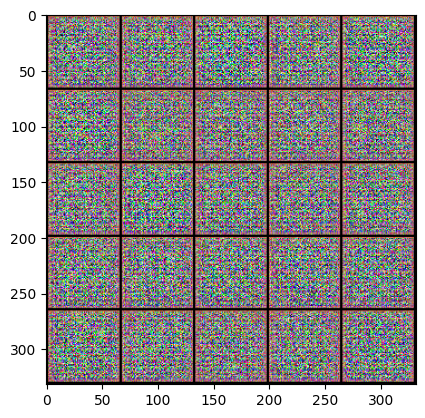

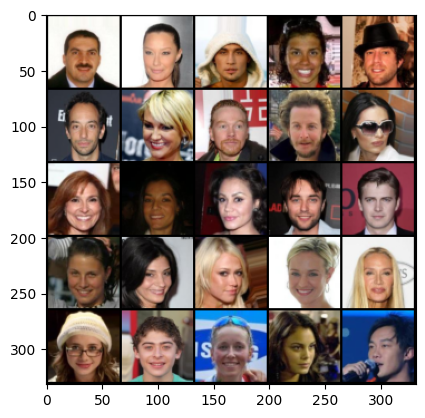

Step 50: Generator loss: 1.6242543327808379, discriminator loss: 0.9311303144693375


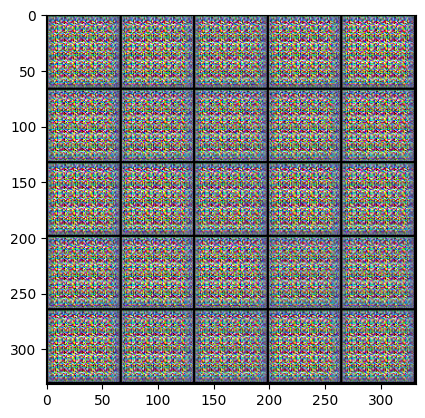

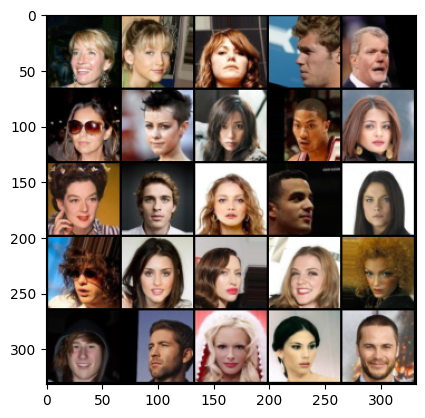

epoch: 2/15


  0%|          | 0/79 [00:00<?, ?it/s]

Step 100: Generator loss: 2.590753221511841, discriminator loss: 0.5187061941623686


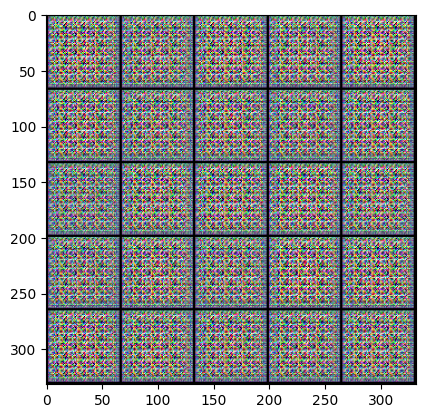

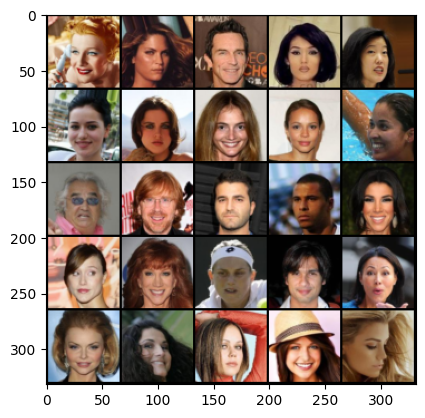

Step 150: Generator loss: 3.0659534358978275, discriminator loss: 0.3798838156461716


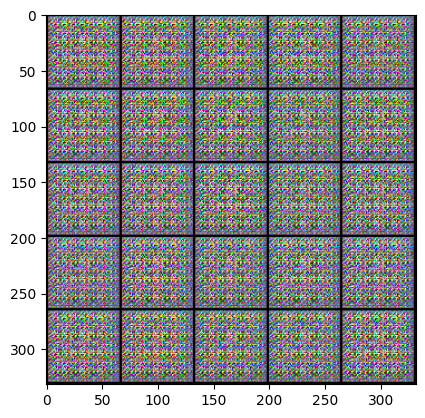

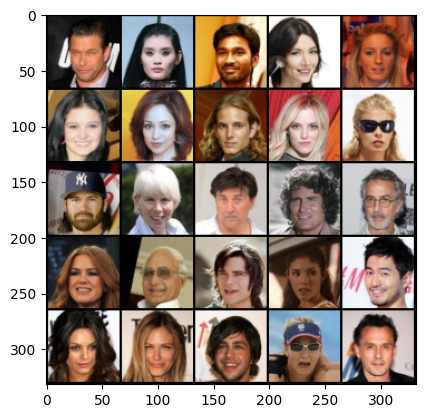

epoch: 3/15


  0%|          | 0/79 [00:00<?, ?it/s]

Step 200: Generator loss: 3.4419837284088137, discriminator loss: 0.2734927123785019


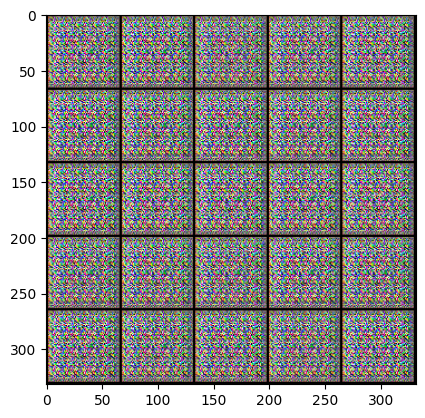

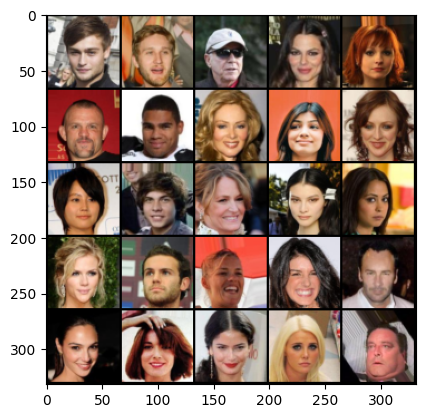

epoch: 4/15


  0%|          | 0/79 [00:00<?, ?it/s]

Step 250: Generator loss: 3.5627558565139767, discriminator loss: 0.19407391116023065


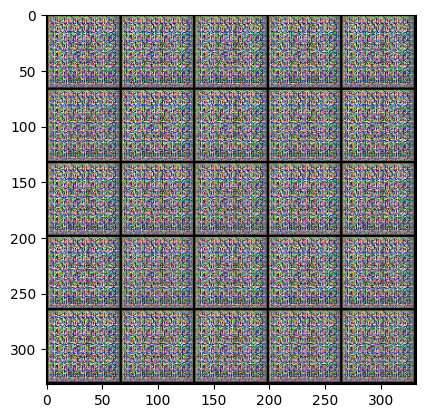

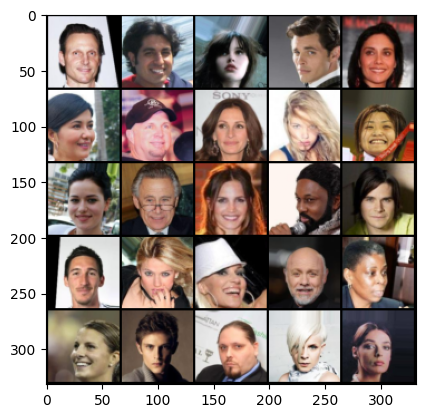

Step 300: Generator loss: 3.701901640892029, discriminator loss: 0.15290345773100858


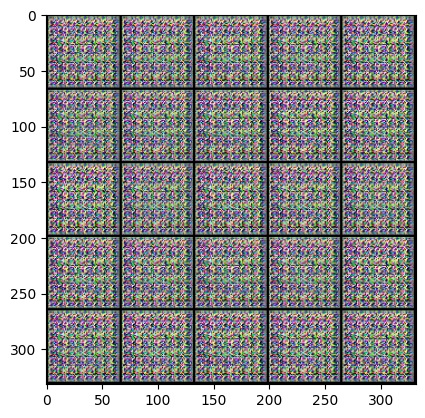

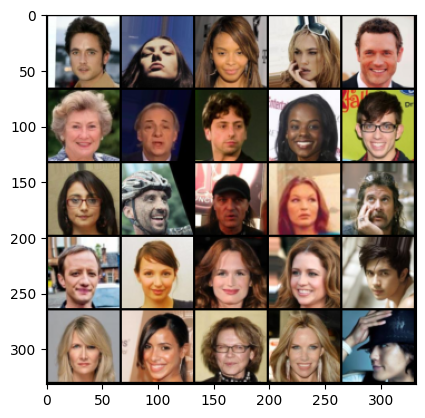

epoch: 5/15


  0%|          | 0/79 [00:00<?, ?it/s]

Step 350: Generator loss: 3.7744951009750363, discriminator loss: 0.11871794611215593


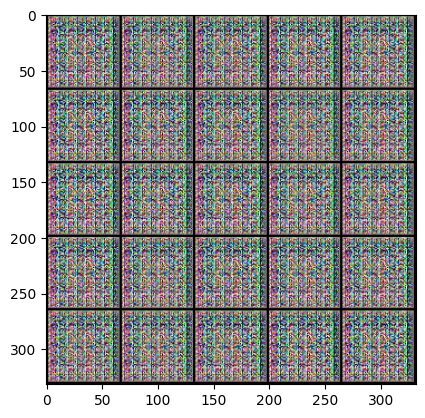

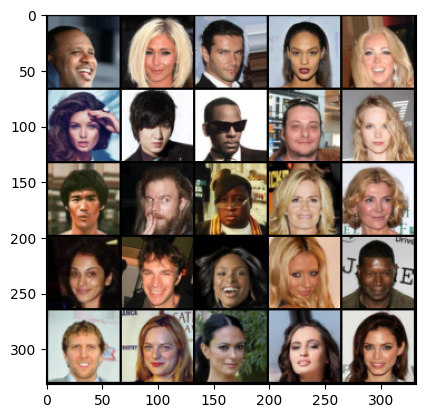

epoch: 6/15


  0%|          | 0/79 [00:00<?, ?it/s]

Step 400: Generator loss: 3.9722416877746585, discriminator loss: 0.10446832180023193


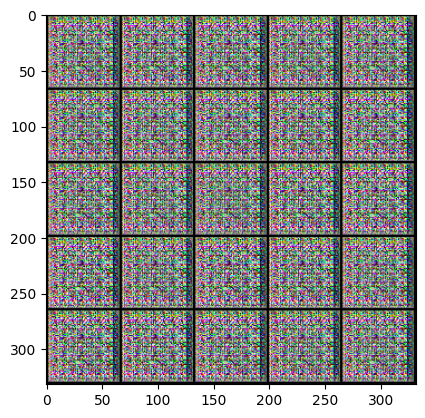

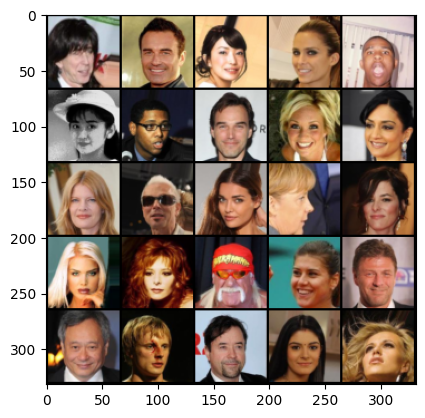

Step 450: Generator loss: 3.998779096603394, discriminator loss: 0.07927689529955385


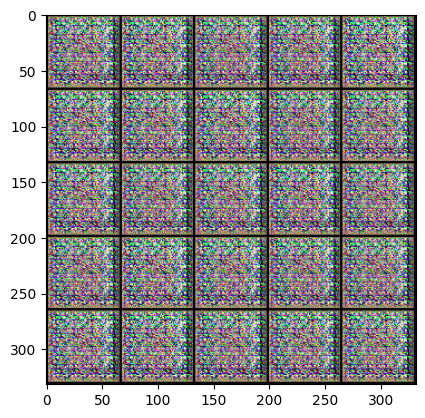

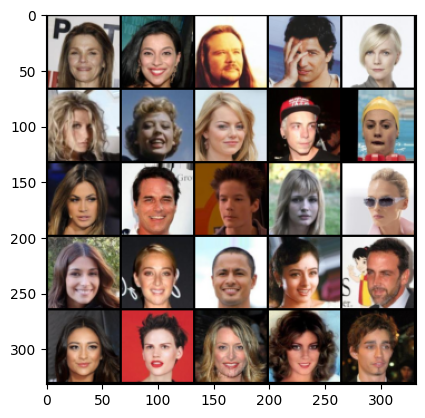

epoch: 7/15


  0%|          | 0/79 [00:00<?, ?it/s]

Step 500: Generator loss: 4.345028176307678, discriminator loss: 0.2273947691172362


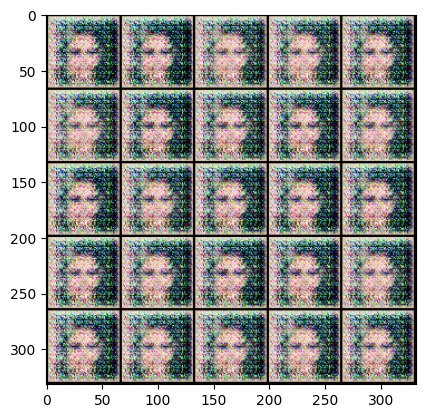

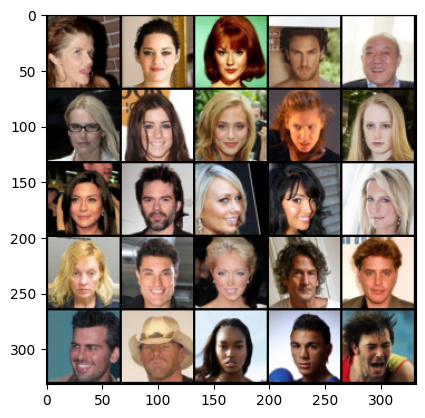

Step 550: Generator loss: 3.6858749568462374, discriminator loss: 0.45836633086204515


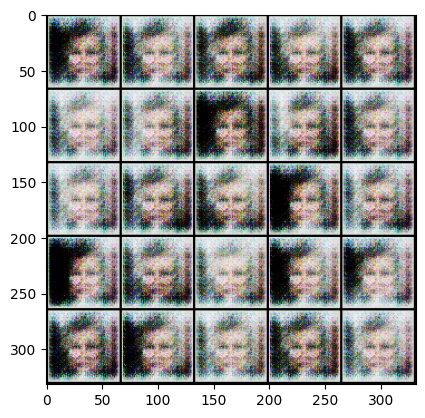

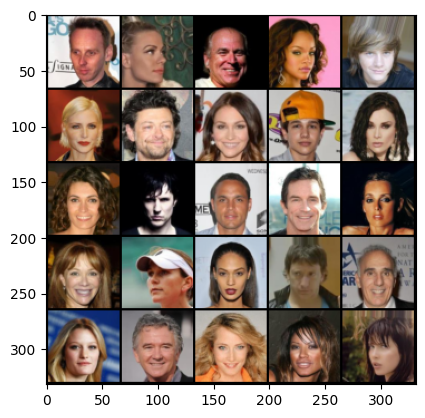

epoch: 8/15


  0%|          | 0/79 [00:00<?, ?it/s]

Step 600: Generator loss: 2.3672009384632116, discriminator loss: 0.6127948617935182


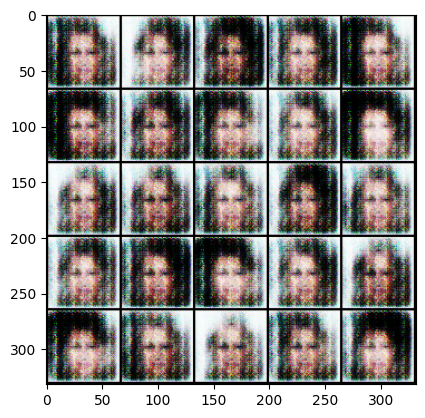

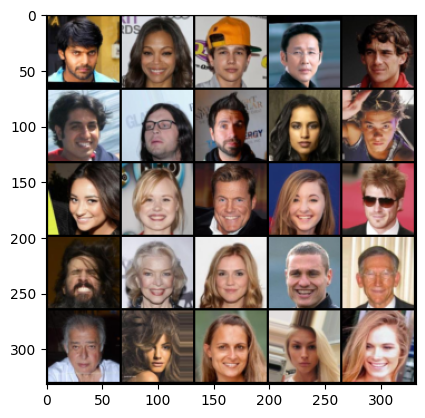

epoch: 9/15


  0%|          | 0/79 [00:00<?, ?it/s]

Step 650: Generator loss: 2.2937708997726434, discriminator loss: 0.5550703471899033


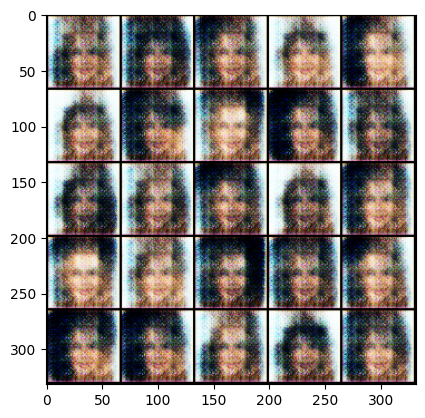

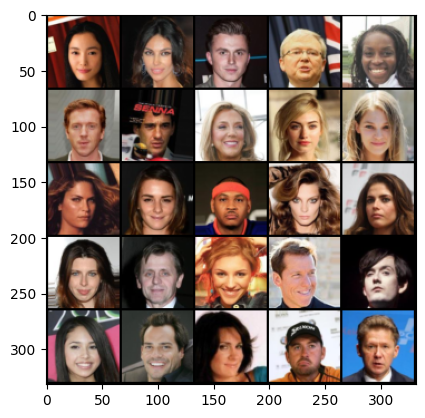

Step 700: Generator loss: 2.2899300503730773, discriminator loss: 0.5405830490589142


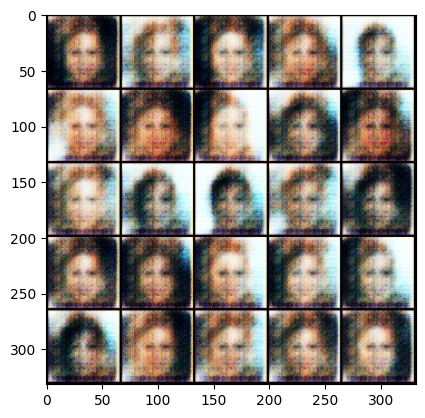

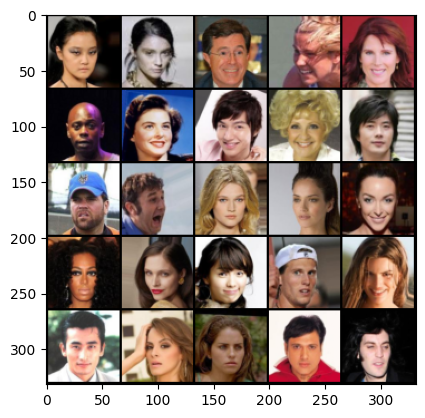

epoch: 10/15


  0%|          | 0/79 [00:00<?, ?it/s]

Step 750: Generator loss: 2.071879831552505, discriminator loss: 0.5410668212175369


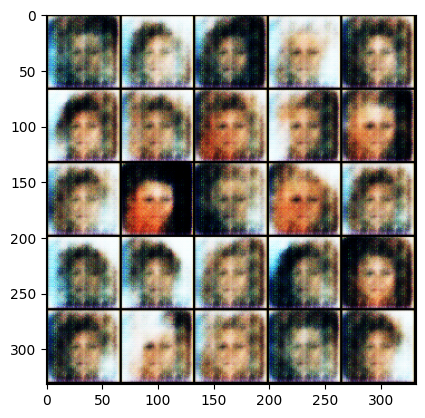

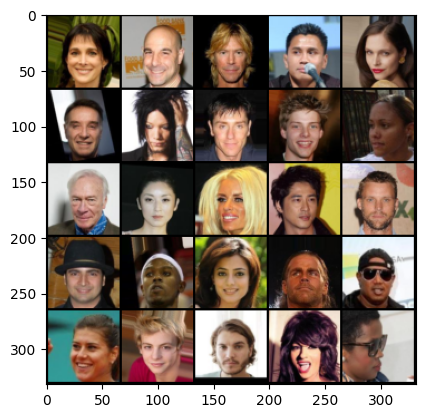

epoch: 11/15


  0%|          | 0/79 [00:00<?, ?it/s]

Step 800: Generator loss: 1.9907197630405429, discriminator loss: 0.5353778487443923


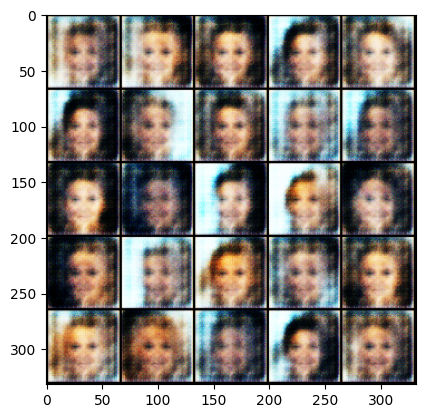

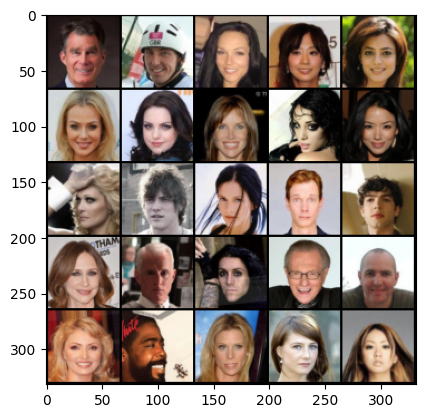

Step 850: Generator loss: 2.035670524835586, discriminator loss: 0.5600290292501449


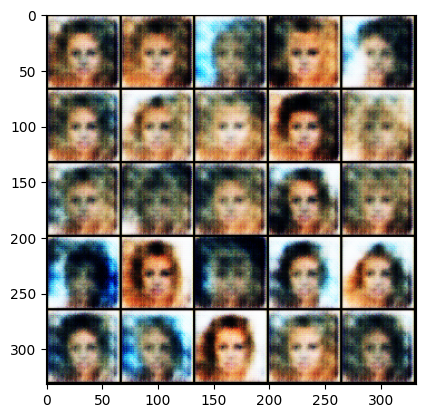

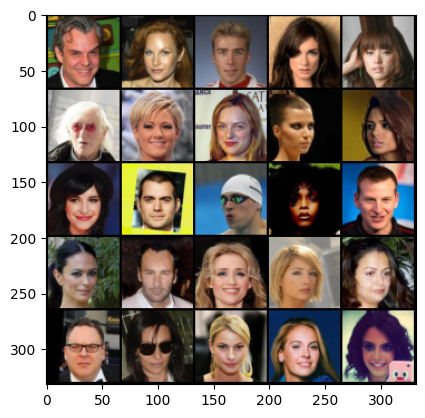

epoch: 12/15


  0%|          | 0/79 [00:00<?, ?it/s]

Step 900: Generator loss: 1.6170513117313385, discriminator loss: 0.6295915150642396


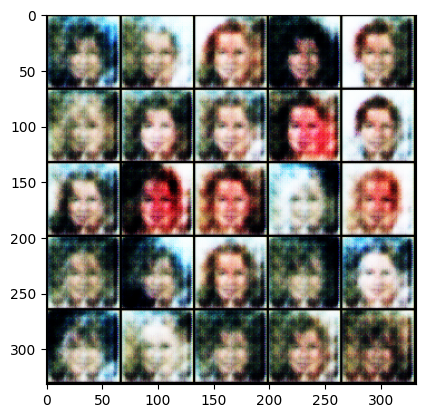

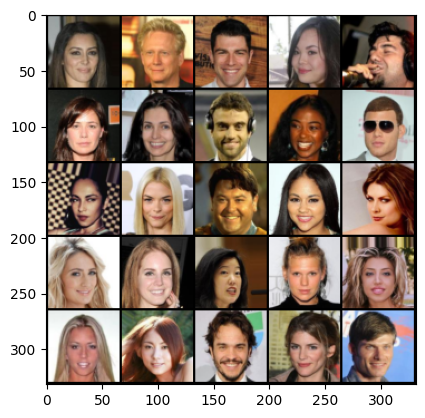

epoch: 13/15


  0%|          | 0/79 [00:00<?, ?it/s]

Step 950: Generator loss: 1.5555616259574894, discriminator loss: 0.6154654300212858


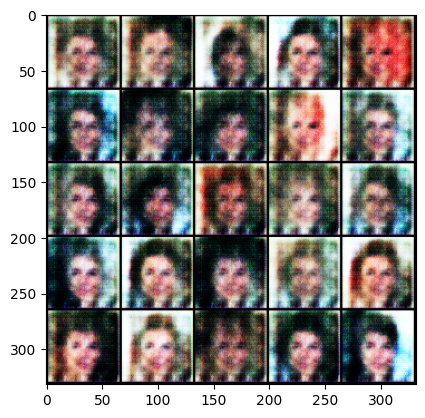

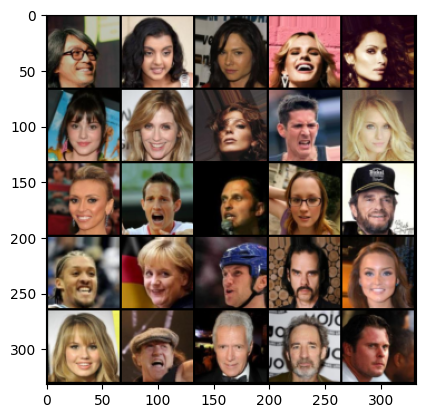

Step 1000: Generator loss: 1.5360602331161504, discriminator loss: 0.6025945234298704


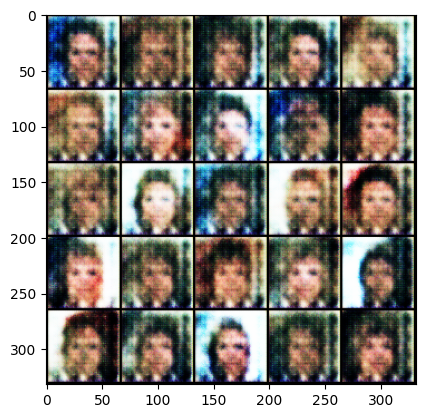

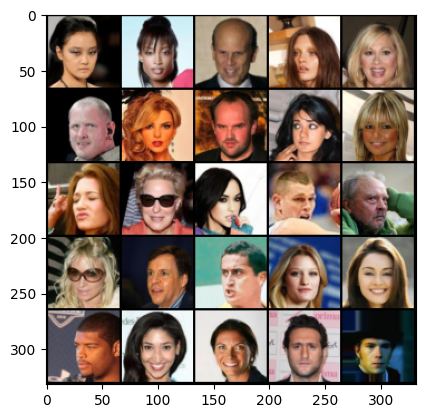

epoch: 14/15


  0%|          | 0/79 [00:00<?, ?it/s]

Step 1050: Generator loss: 1.570511658191681, discriminator loss: 0.5786605995893478


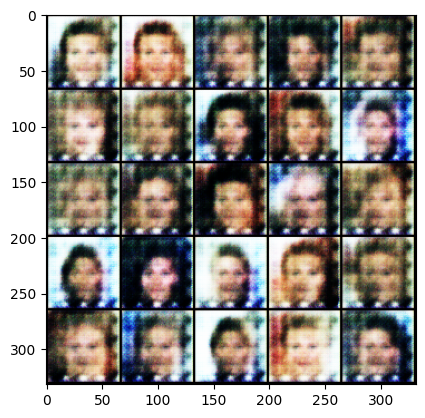

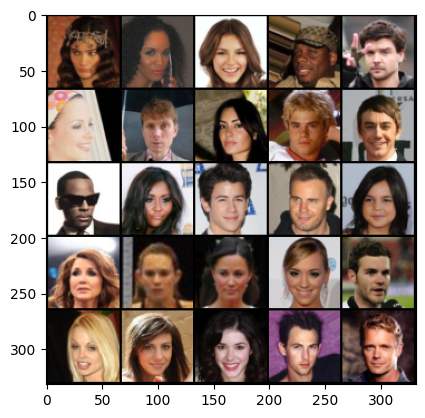

Step 1100: Generator loss: 1.6111513566970825, discriminator loss: 0.5478557479381562


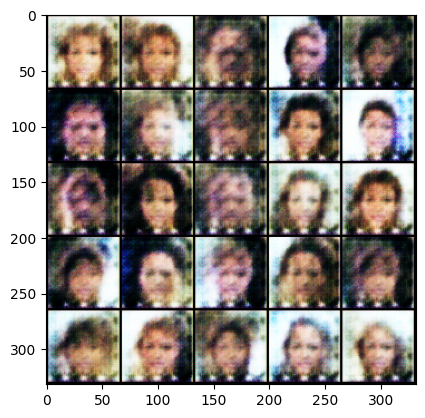

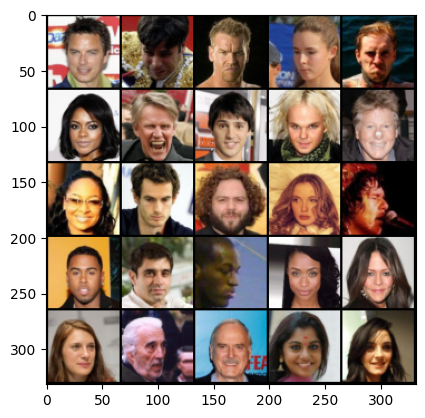

epoch: 15/15


  0%|          | 0/79 [00:00<?, ?it/s]

Step 1150: Generator loss: 1.6990149199962614, discriminator loss: 0.5717318654060363


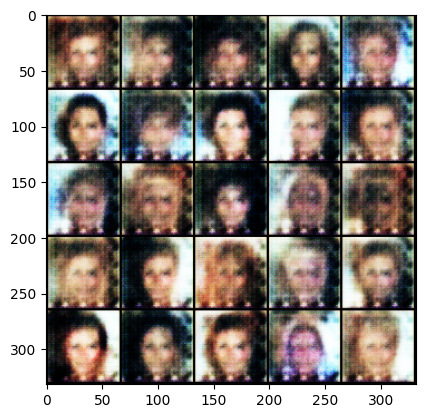

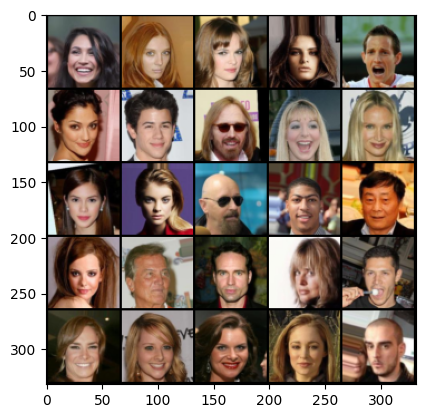

In [ ]:
criterion = nn.BCEWithLogitsLoss()  # BCEWithLogitsLoss = Sigmoid layer + BCELoss
display_step = 50

n_epochs = 15
cur_step = 0
mean_generator_loss = 0
mean_discriminator_loss = 0

for epoch in range(n_epochs):
    print(f'epoch: {epoch+1}/{n_epochs}')
    for real, _ in tqdm(dataloader):
        real = real.to(device)

        '''
        Discriminator 업데이트
        '''
        disc_optimizer.zero_grad()  # 최적화된 모든 변수 초기화

        # [Generator의 input] random noise 생성
        noise = torch.randn(batch_size, z_dim, 1, 1, device=device)
        # [Generator] random noise로부터 이미지 생성하기
        fake_images = gen(noise)
        # [Discriminator] 생성된 이미지(fake)를 넣었을 때의 판별 결과
        logits_fake = disc(fake_images.detach())
        # [Discriminator] 실제 이미지(real)를 넣었을 때의 판별 결과
        logits_real = disc(real)

        # [Discriminator Loss]
        # fake(0)는 0으로, real은 1로 만들기 == fake영상은 fake로 판별, real 영상은 real로 판별
        disc_loss_fake = criterion(logits_fake, torch.zeros_like(logits_fake)) # fake : 0
        disc_loss_real = criterion(logits_real, torch.ones_like(logits_real))  # real : 1
        disc_loss = (disc_loss_fake + disc_loss_real) / 2   # discriminator의 최종 loss

        mean_discriminator_loss += disc_loss.item() / display_step  # epoch별 Discriminator 평균 loss

        disc_loss.backward(retain_graph=True)
        disc_optimizer.step()

        '''
        Generator 업데이트
        '''
        gen_optimizer.zero_grad()  # 최적화된 모든 변수 초기화

        # [Generator의 input] random noise 생성
        noise = torch.randn(batch_size, z_dim, 1, 1, device=device)
        # [Generator] random noise로부터 이미지 생성하기
        fake_images = gen(noise)
        # [Discriminator] 생성된 이미지(fake)를 넣었을 때의 판별 결과
        logits_fake = disc(fake_images)

        # [Generator Loss]
        # 생성된 이미지(fake)를 Discriminator가 real(1)로 판단하도록 구성
        gen_loss = criterion(logits_fake, torch.ones_like(logits_fake))

        mean_generator_loss += gen_loss.item() / display_step  # epoch별 Generator 평균 loss

        gen_loss.backward()
        gen_optimizer.step()


        ## Visualization code ##
        if cur_step % display_step == 0 or cur_step == 0 or epoch == n_epochs:
            print(f"Step {cur_step}: Generator loss: {mean_generator_loss}, discriminator loss: {mean_discriminator_loss}")
            show_tensor_images(fake_images)   # generator로 생성한 이미지 화면에 나타내기
            show_tensor_images(real)          # 실제 real 이미지 화면에 나타내기
            mean_generator_loss = 0
            mean_discriminator_loss = 0
        cur_step += 1

# 실습
논문에서는 최적의 GAN모델 구조를 찾아낼 뿐만아니라 <U>입력 데이터로 사용하는 input noise에 대한 의미를 발견</U>하였습니다.<br>
Generator의 input값인 random noise값을 통한 **vector arithmetic(산수)** 가 가능함을 보였는데요, 아래 사진을 통해 자세하게 살펴보도록 하겠습니다.

## Linear arithmetic

![ex1](https://user-images.githubusercontent.com/46768752/142651925-53a751e0-c198-47c8-b230-96201c5b1298.png)

- vector(안경 낀 남자) - vector(안경 끼지 않은 남자) + vector(안경 끼지 않은 여자) = vector(안경 낀 여자)
- random noise vector값은 각각 영상이 갖고 있는 representation을 나타낸다는 것을 알 수 있습니다.


## Interpolation

![ex2](https://user-images.githubusercontent.com/46768752/142652431-9377ac6b-b6d0-4f55-a04a-d2526add011a.png)
- 두 벡터에 대한 interpolation 수행
- 서로 다른 2개의 random noise vector에 일정한 가중치를 주어 합칠 경우 위와 같은 결과가 나오게 됩니다.

noise로부터 generator가 생성한 사진을 확인해보겠습니다.

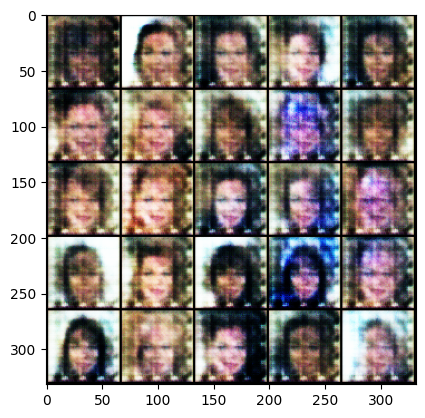

In [ ]:
noise = torch.randn(batch_size, z_dim, 1, 1, device=device)  # [Generator의 input] random noise 생성
fake_images = gen(noise)    # [Generator] random noise로부터 이미지 생성하기
show_tensor_images(fake_images)  # Generator로 생성한 이미지 화면에 보이기

In [ ]:
# 위에서 구한 noise 하나 뽑아보기
print(f'noise shape: {noise.shape}')  # torch.Size([128(batch_size), 100, 1, 1])

noise0 = noise[0].unsqueeze(0)  # (100, 1, 1)->(1, 100, 1, 1)
print(noise0.squeeze())

noise shape: torch.Size([128, 100, 1, 1])
tensor([ 0.5700,  0.3929, -1.0564, -1.3468,  0.0185, -0.9824,  0.5354, -0.8743,
         1.2545,  0.1947, -0.1137, -0.2725,  0.9760, -2.8339,  3.2153, -0.7116,
         0.2322,  0.4137, -1.0245,  1.1237,  0.9561, -0.3475,  0.5110,  0.4672,
         0.1786,  0.3063, -2.3633,  0.8496, -1.2428,  0.4823, -1.6942, -1.6948,
         0.8009,  1.2485, -0.3301,  1.1021, -0.1301, -0.9784,  2.4808,  1.0262,
         1.6658, -1.0181, -1.1727,  0.8472, -0.1415,  0.2181, -2.8698, -0.5832,
        -1.7246,  0.4002, -0.2234, -0.8300, -0.3004,  0.7897, -0.2418,  0.6078,
         1.8402,  1.1820, -0.7047,  0.3651,  0.3968, -1.0339, -1.0893, -1.0015,
        -0.5840,  0.3188,  1.0713,  0.0980, -0.6424,  1.0119, -1.1161, -1.7468,
        -0.6266,  0.5412, -0.7375,  0.0460,  1.0962,  0.2885,  0.3590,  1.8758,
         1.1103, -1.7804,  2.1581, -0.8092, -1.1158,  1.2628,  0.5906, -0.7172,
         1.1716, -0.7209,  1.9459,  1.1853, -0.6093,  0.7958, -0.2323, -0.5815

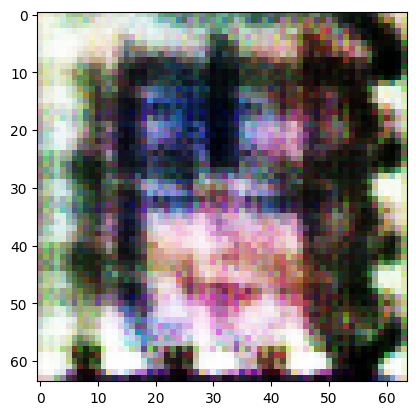

In [ ]:
# 뽑아낸 noise를 통해 generator 가짜 이미지 만들기
gen_fake_images0 = gen(noise0)
show_tensor_images(gen_fake_images0)

# 실습 과제: Interpolation

![ex2](https://user-images.githubusercontent.com/46768752/142652431-9377ac6b-b6d0-4f55-a04a-d2526add011a.png)

- 서로 다른 2개의 random noise vector에 일정한 가중치를 주어 합칠 경우 위와 같은 결과가 나오게 됩니다.
- 임의의 두 이미지를 생성하고, 그 두 이미지 사이에 나타날 수 있는 합성이미지 10개가지를 interpolation을 통해 출력하시오.

* new_noise = $\alpha$ noise_a +  $(1-\alpha)$ noise_b


## (보너스) Linear arithmetic

- 실습 시간이 남는 경우 Linear arithmetic도 구현해보세요.
- 예: vector(안경 낀 남자) - vector(안경 끼지 않은 남자) + vector(안경 끼지 않은 여자) = vector(안경 낀 여자)
- random noise vector값은 각각 영상이 갖고 있는 representation을 나타낸다는 것을 알 수 있습니다.





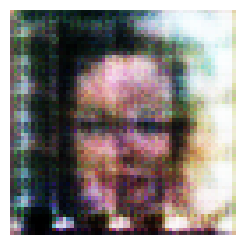

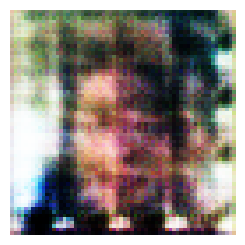

torch.Size([100, 1, 1]) torch.Size([100, 1, 1])


In [ ]:
########################################

# 여러분의 실습 답안을 이곳에 입력하세요.
'''
batch_size: 생성할 이미지의 개수
z_dim: 노이즈 벡터의 차원 수
1: 높이
1: 너비
'''
noise = torch.randn(2, z_dim, 1, 1, device=device)  # [Generator의 input] random noise 생성

noise_a = noise[0].unsqueeze(0)  # (100, 1, 1)->(1, 100, 1, 1)
noise_b = noise[1].unsqueeze(0)  # (100, 1, 1)->(1, 100, 1, 1)

plt.subplot(1,2,1)
plt.axis('off')
gen_fake_images_a = gen(noise_a)
show_tensor_images(gen_fake_images_a)


plt.subplot(1,2,2)
plt.axis('off')
gen_fake_images_b = gen(noise_b)
show_tensor_images(gen_fake_images_b)

plt.show
print(noise[0].shape, noise[1].shape)


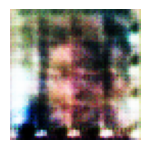

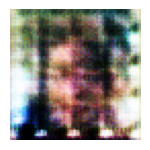

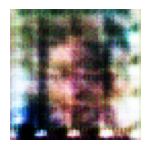

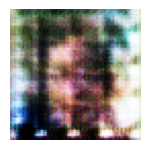

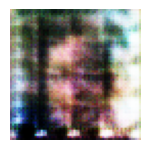

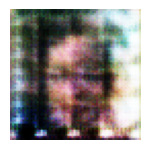

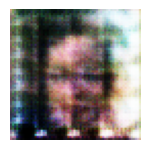

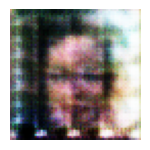

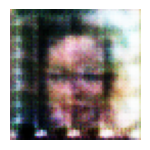

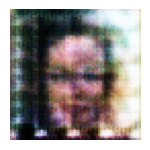

In [ ]:
alpha = 0.1
for i in range(10):
  plt.figure(figsize=(20,20))

  new_noise = alpha * noise_a + (1 - alpha) * noise_b
  plt.subplot(10, 1, i+1)
  gen_fake_image_new = gen(new_noise)

  plt.axis('off')
  show_tensor_images(gen_fake_image_new)
  alpha += 0.1

plt.show()

# References
[1.] [Unsupervised Representation Learning with Deep Convolutional Generative Adversarial Networks](https://arxiv.org/pdf/1511.06434.pdf)

[2.] [Generative Adversarial Networks (GANs) Specialization](https://www.coursera.org/specializations/generative-adversarial-networks-gans)

[3.] [DCGAN Tutorial - PyTorch Official](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html)

I would highly recommend [GANs Specialization](https://www.coursera.org/specializations/generative-adversarial-networks-gans) on Coursera if you want to learn GANs in depth.

---

[4.] [DCGAN-라온피플 머신러닝 아카데미] (https://blog.naver.com/PostView.nhn?blogId=laonple&logNo=221201915691)

[5.] [DCGAN 튜토리얼] (https://tutorials.pytorch.kr/beginner/dcgan_faces_tutorial.html)